# Project 07: Logistic Regression & Prediction in R

1. fit the logistic model
2. dominance analysis > choose the best model by dominance analysis
3. choose the stepwise logistic model
4. compare these two
5. apply the model to test data
6. make predictions

### 1. Data preparation & Simple EDA

In [1]:
# Set up the path for installing packages
.libPaths('C:/Users/james/anaconda3/envs/r-tutorial/Lib/R/library')

In [2]:
# install.packages('utils')

In [3]:
# Load packages
library(data.table)
library(magrittr)
library(naniar)
library(dplyr)
library(skimr)
library(ggplot2)
library(yardstick)
library(dominanceanalysis)
library(caTools)  # Split dataset into training data and testing data
library(ggiraphExtra)
library(pscl)
library(MASS)
library(caret)
library(workflows)

Warning message:
"package 'data.table' was built under R version 3.6.3"Warning message:
"package 'magrittr' was built under R version 3.6.3"Warning message:
"package 'naniar' was built under R version 3.6.3"Warning message:
"package 'dplyr' was built under R version 3.6.3"
Attaching package: 'dplyr'

The following objects are masked from 'package:data.table':

    between, first, last

The following objects are masked from 'package:stats':

    filter, lag

The following objects are masked from 'package:base':

    intersect, setdiff, setequal, union

Warning message:
"package 'skimr' was built under R version 3.6.3"
Attaching package: 'skimr'

The following object is masked from 'package:naniar':

    n_complete

Warning message:
"package 'ggplot2' was built under R version 3.6.3"Warning message:
"package 'yardstick' was built under R version 3.6.3"For binary classification, the first factor level is assumed to be the event.
Use the argument `event_level = "second"` to alter this as n

In [4]:
# Set up the working directory
setwd('C:/Users/james/Desktop/Coding/Kaggle/Health Insurance')

# Inspect the workspace
dir()

# Import trainng & testing dataset train.csv with fread()
train_df <- fread("train.csv")
test_df <- fread("test.csv")

# Call head() and tail() on training data: train_df
head(train_df)
tail(train_df)

[1] "data descriptions.txt" "test.csv"              "train.csv"

id,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage,Response
1,Male,44,1,28,0,> 2 Years,Yes,40454,26,217,1
2,Male,76,1,3,0,1-2 Year,No,33536,26,183,0
3,Male,47,1,28,0,> 2 Years,Yes,38294,26,27,1
4,Male,21,1,11,1,< 1 Year,No,28619,152,203,0
5,Female,29,1,41,1,< 1 Year,No,27496,152,39,0
6,Female,24,1,33,0,< 1 Year,Yes,2630,160,176,0


id,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage,Response
381104,Male,47,1,50,0,1-2 Year,Yes,39831,26,235,0
381105,Male,74,1,26,1,1-2 Year,No,30170,26,88,0
381106,Male,30,1,37,1,< 1 Year,No,40016,152,131,0
381107,Male,21,1,30,1,< 1 Year,No,35118,160,161,0
381108,Female,68,1,14,0,> 2 Years,Yes,44617,124,74,0
381109,Male,46,1,29,0,1-2 Year,No,41777,26,237,0


In [5]:
# Quick EDA to take a look at the training dataset
skimr::skim(train_df)

-- Data Summary ------------------------
                           Values  
Name                       train_df
Number of rows             381109  
Number of columns          12      
_______________________            
Column type frequency:             
  character                3       
  numeric                  9       
________________________           
Group variables            None    

-- Variable type: character ----------------------------------------------------
# A tibble: 3 x 8
  skim_variable  n_missing complete_rate   min   max empty n_unique whitespace
* <chr>              <int>         <dbl> <int> <int> <int>    <int>      <int>
1 Gender                 0             1     4     6     0        2          0
2 Vehicle_Age            0             1     8     9     0        3          0
3 Vehicle_Damage         0             1     2     3     0        2          0

-- Variable type: numeric ------------------------------------------------------
# A tibble: 9 x 11
  s

### 2. Fitting a logistic regression model
#### (a) Computing full logistic regression model

In [6]:
# Fit the model to the train_df without interaction
# and predictiors not considered important: id

mdl_full <- glm(Response ~ Gender + Age + Driving_License + Region_Code + Previously_Insured + 
                    Vehicle_Age + Vehicle_Damage + Policy_Sales_Channel + Annual_Premium + Vintage,
                    data = train_df,
                    family = "binomial")

In [7]:
# Summarized result of the full model
summary(mdl_full)$coef  # ex) 2e-16 = 2.0 * 10-16

,Estimate,Std. Error,z value,Pr(>|z|)
(Intercept),-4.069992e+00,1.703252e-01,-23.8954187,3.417753e-126
GenderMale,9.069199e-02,1.112765e-02,8.1501496,3.634744e-16
Age,-2.534699e-02,5.456881e-04,-46.4495813,0.000000e+00
Driving_License,1.211306e+00,1.634255e-01,7.4119766,1.244307e-13
Region_Code,-3.675970e-04,4.356946e-04,-0.8437034,3.988352e-01
Previously_Insured,-3.972821e+00,8.264785e-02,-48.0692625,0.000000e+00
Vehicle_Age> 2 Years,1.381333e+00,2.695875e-02,51.2387568,0.000000e+00
Vehicle_Age1-2 Year,1.172105e+00,1.880177e-02,62.3401161,0.000000e+00
Vehicle_DamageYes,2.028059e+00,3.426529e-02,59.1869765,0.000000e+00
Policy_Sales_Channel,-2.441376e-03,1.094706e-04,-22.3016518,3.561103e-110


#### Observations

1. Except for Vintage and Region_Code, all other variables are statistically significant predictors(p < 0.05).
2. All significant predictors, except for Age, Region_Code, Policy_Sales_Channel, Previously_Insured and Vintage, have a positive coefficient.

#### (2) Computing stepwise logistic regression

In [8]:
# fit the model
mdl_step <- glm(Response ~ Gender + Age + Driving_License + Region_Code + Previously_Insured + 
                    Vehicle_Age + Vehicle_Damage + Policy_Sales_Channel + Annual_Premium + Vintage,
                    data = train_df,
                    family = "binomial") %>%
                    stepAIC(trace = FALSE)

# Summarize the final selected model
summary(mdl_step)$coef

,Estimate,Std. Error,z value,Pr(>|z|)
(Intercept),-4.080521e+00,1.696599e-01,-24.051188,8.112272e-128
GenderMale,9.080387e-02,1.112682e-02,8.160813,3.327759e-16
Age,-2.535045e-02,5.456680e-04,-46.457644,0.000000e+00
Driving_License,1.210940e+00,1.634228e-01,7.409861,1.264318e-13
Previously_Insured,-3.972858e+00,8.264784e-02,-48.069709,0.000000e+00
Vehicle_Age> 2 Years,1.381141e+00,2.695760e-02,51.233843,0.000000e+00
Vehicle_Age1-2 Year,1.172021e+00,1.880127e-02,62.337339,0.000000e+00
Vehicle_DamageYes,2.027891e+00,3.426464e-02,59.183178,0.000000e+00
Policy_Sales_Channel,-2.439167e-03,1.094386e-04,-22.287990,4.832077e-110
Annual_Premium,2.574046e-06,2.956401e-07,8.706688,3.128833e-18


#### Observations

1. As I expected, the function chose a final model in which two variables, Region_Code and Vintage, have been removed from the original full model.

### 3. Quantifying logistic regression fit
1. In this chapter, I will:
    1. compare the full logistic regression model with the stepwise logistic regression model with model performance metrics.
    2. arbitrarily narrow down the predictors by comparing their contribution to the residual deviance reduction. 
    

#### (1) Comparing the full and the stepwise models with Prediction Accuracy
1. I will compare the performance of the full and stepwise logistic model. 
2. The best model is defined as the model that has the lowest classification error rate in predicting the class of new test data.
3. Let's compare the prediction accuracy of each model.

#### (a) Full model

In [9]:
mdl_full <- glm(Response ~ Gender + Age + Driving_License + Region_Code + Previously_Insured + 
                    Vehicle_Age + Vehicle_Damage + Policy_Sales_Channel + Annual_Premium + Vintage,
                    data = train_df,
                    family = "binomial")

actual_response <- train_df$Response
predicted_response <- round(fitted(mdl_full))

outcomes <- table(predicted_response, actual_response)
outcomes

                  actual_response
predicted_response      0      1
                 0 334388  46704
                 1     11      6

In [10]:
confusion <- conf_mat(outcomes)
summary(confusion, event_level = "second")[1:4, ]

.metric,.estimator,.estimate
accuracy,binary,0.8774235193
kap,binary,0.0001676449
sens,binary,0.0001284522
spec,binary,0.9999671052


#### (b) Stepwise model

In [11]:
mdl_step <- glm(Response ~ Gender + Age + Driving_License + Previously_Insured + 
                    Vehicle_Age + Vehicle_Damage + Policy_Sales_Channel + Annual_Premium,
                    data = train_df,
                    family = "binomial")

actual_response <- train_df$Response
predicted_response <- round(fitted(mdl_step))

outcomes <- table(predicted_response, actual_response)
outcomes

                  actual_response
predicted_response      0      1
                 0 334387  46703
                 1     12      7

In [12]:
confusion <- conf_mat(outcomes)
summary(confusion, event_level = "second")[1:4, ]

.metric,.estimator,.estimate
accuracy,binary,0.8774235193
kap,binary,0.0001999513
sens,binary,0.0001498608
spec,binary,0.9999641147


#### (2) With k-fold Cross Validation
#### (a) Full model

In [13]:
# Define training control
train_control <- trainControl(method = "cv", number = 10)  

# Train the model on training set
mdl_full_cv <- train(Response ~ .,
                       data = train_df,
                       trControl = train_control,
                       method = "glm",
                       family = binomial()
                       )

# Print cv scores
mdl_full_cv$results

Warning message in train.default(x, y, weights = w, ...):
"You are trying to do regression and your outcome only has two possible values Are you trying to do classification? If so, use a 2 level factor as your outcome column."

parameter,RMSE,Rsquared,MAE,RMSESD,RsquaredSD,MAESD
none,0.2995539,0.1655978,0.1795139,0.001573853,0.00155201,0.001253822


#### (b) Stepwise model

In [14]:
# Define training control
train_control <- trainControl(method = "cv", number = 10)

# Train the model on training set
mdl_step_cv <- train(Response ~ Gender + Age + Driving_License + Previously_Insured + 
                       Vehicle_Age + Vehicle_Damage + Policy_Sales_Channel + Annual_Premium,
                       data = train_df,
                       trControl = train_control,
                       method = "glm",
                       family = binomial()
                       )

# Print cv scores
mdl_step_cv$results

Warning message in train.default(x, y, weights = w, ...):
"You are trying to do regression and your outcome only has two possible values Are you trying to do classification? If so, use a 2 level factor as your outcome column."

parameter,RMSE,Rsquared,MAE,RMSESD,RsquaredSD,MAESD
none,0.2995551,0.165605,0.1795151,0.001387712,0.002606489,0.001087288


#### (3) Other model performance metrics
#### (a) McFadden's pseudo R-squared
1. McFadden's pseudo R-squared is sometimes referred to as a closer equivalent of the coefficient of determination, R-squared, in linear regressions. 
2. McFadden's R-squared tend to be considerably lower than those of the R-squared index.
    * For example, values of 0.2 to 0.4 for McFadden's R-squared represent excellent model fit.

In [15]:
# Obtain McFadden's pseudo R-squared for the full model
round(pR2(mdl_full), digits = 4)

fitting null model for pseudo-r2


llh      llhNull           G2     McFadden         r2ML         r2CU 
-104750.9806 -141773.0765   74044.1917       0.2611       0.1766       0.3365

In [16]:
# Obtain McFadden's pseudo R-squared for the stepwise model
round(pR2(mdl_step), digits = 4)

fitting null model for pseudo-r2


llh      llhNull           G2     McFadden         r2ML         r2CU 
-104751.3425 -141773.0765   74043.4680       0.2611       0.1766       0.3365

#### Observations

As seen above, McFadden's index is about 0.26 for both models indicating that they are greatly fitted.

#### (b) Residual deviance reduction
Let's get the detailed table of deviance from the stepwise model

In [17]:
# Return a table of deviance
df <- anova(mdl_step, test = "Chisq")
df

# Extract the column: Residual Deviance
df1 <- subset(df, select = c("Resid. Dev"))
df1

,Df,Deviance,Resid. Df,Resid. Dev,Pr(>Chi)
NULL,NA,NA,381108,283546.2,NA
Gender,1,1058.14502,381107,282488.0,4.130355e-232
Age,1,4002.12514,381106,278485.9,0.000000e+00
Driving_License,1,143.97930,381105,278341.9,3.590187e-33
Previously_Insured,1,56009.88369,381104,222332.0,0.000000e+00
Vehicle_Age,2,5990.06873,381102,216342.0,0.000000e+00
Vehicle_Damage,1,6190.02350,381101,210151.9,0.000000e+00
Policy_Sales_Channel,1,573.91643,381100,209578.0,7.895742e-127
Annual_Premium,1,75.32623,381099,209502.7,3.990231e-18


,Resid. Dev
NULL,283546.2
Gender,282488.0
Age,278485.9
Driving_License,278341.9
Previously_Insured,222332.0
Vehicle_Age,216342.0
Vehicle_Damage,210151.9
Policy_Sales_Channel,209578.0
Annual_Premium,209502.7


In [18]:
# Loop over the rows to compute the difference in deviance between rows
for(i in 1:nrow(df1)) {
    diff_vars <- df1[i, ] - df1[i+1, ]
    
    if (i == 9) {
        break
    }
    print(round(diff_vars, digits = 2))
}

[1] 1058.15
[1] 4002.13
[1] 143.98
[1] 56009.88
[1] 5990.07
[1] 6190.02
[1] 573.92
[1] 75.33


vars,resid_dev_reduced
Gender,1058.15
Age,4002.13
Driving_License,143.98
Previously_Insured,56009.88
Vehicle_Age,5990.07
Vehicle_Damage,6190.02
Policy_Sales_Channel,573.92
Annual_Premium,75.33


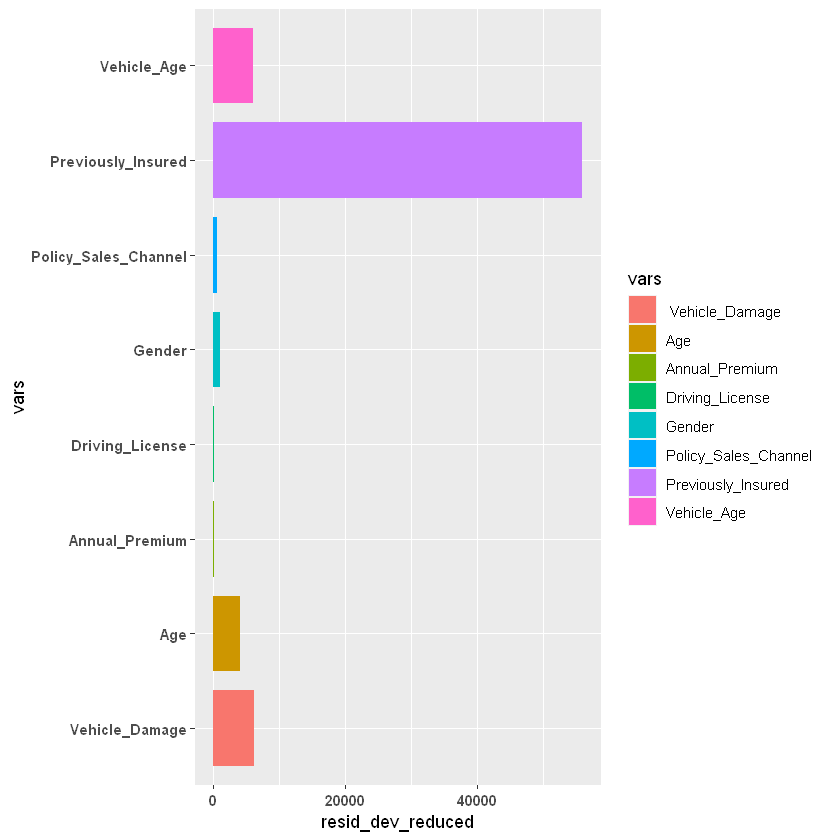

In [19]:
# Create a dataframe that shows variables and its contribution to residual deviance reduction 
vars <- c("Gender", "Age", "Driving_License", "Previously_Insured", "Vehicle_Age",
                        " Vehicle_Damage", "Policy_Sales_Channel", "Annual_Premium")
resid_dev_reduced <- c(1058.15, 4002.13, 143.98, 56009.88, 5990.07, 6190.02, 573.92, 75.33)
diff_df <- data.frame(vars, resid_dev_reduced)
diff_df

# Bar plot
p <- ggplot(diff_df, aes(resid_dev_reduced, vars, fill = vars)) +
    geom_bar(stat = 'identity', width = 0.8)

p + theme(axis.text.x = element_text(face = "bold"),
          axis.text.y = element_text(face = "bold"))

#### Observations


1. First, let's look at the difference between the null deviance, which is the deviance of the null model (i.e., a model with only an intercept), and the residual deviance.
2. The bigger the difference is, the better the model is doing against the null model.
3. I tabulated the residual deviance reduced by each variable and also plotted them in the bar plot for easy comparison.
4. As seen above, adding the ownership of vehicle insurance; Previously_Insured, alone reduces the residual deviance drastically. 
5. On the other hand, the predictors whose residual deviance reduction is comparatively small, such as Policy_Sales_Channel, Gender, Driving_License, and Annual_Premium, indicate that these variables do not add much to the model.

### 4. Making predictions

In [20]:
predict(mdl_step, test_df)
prob_purchase = rep(NA, nrow(test_df))

for(i in 1:nrwo(test_df)) {
    prob_purchase = predict(dml_step, test_df[i, ], type = "response")
    
    if(prob_purchase < 0.5) {
        prob_purchase[i] = 0
    }
    else {
        prob_purchase[i] = 1
    }
}

head(prob_purchase, n = 100)

1             2             3             4             5 
-7.6640349512 -0.5230530516 -0.9697031603 -5.6067527129 -7.6547322692 
            6             7             8             9            10 
-7.5766037385 -6.9234436754 -7.6959814358 -0.7002333288 -6.8410228762 
           11            12            13            14            15 
-6.8893190456 -1.2121304645 -7.4176474893 -0.9988181943 -1.3596314432 
           16            17            18            19            20 
-7.3146825010 -1.6455927115 -0.8820648568 -7.6627363051 -7.8331527612 
           21            22            23            24            25 
-7.7858187097 -7.7292335370 -1.6784827732 -0.7910371969 -1.0021548949 
           26            27            28            29            30 
-7.8492470236 -7.6880574245 -6.9171880815 -6.8685354467 -7.8036130895 
           31            32            33            34            35 
-1.6519227733 -7.2784797155 -7.4668992718 -7.6488635242 -1.7588307173 
           36            37            38            39            40 
-0.2546472648 -7.6339997357 -1.6180634391 -7.6137781105 -6.8323669584 
           41            42            43            44            45 
-1.0191370414 -0.7578471164 -7.4821479333 -0.8040610545 -0.7282232580 
           46            47            48            49            50 
-0.4150743604 -7.5595476839 -3.8478038744 -1.2681602003 -1.4209302859 
           51            52            53            54            55 
-0.9515915879 -5.5739256861 -7.6040031309 -0.8125926030 -7.6532767660 
           56            57            58            59            60 
-1.6676561066 -1.6096549956 -7.6241476147 -7.7423354310 -2.9608956010 
           61            62            63            64            65 
-7.7493800195 -7.6354785651 -0.9745354928 -1.5981390068 -7.6556435613 
           66            67            68            69            70 
-7.7177340265 -6.9246702483 -1.0714834392 -1.4212879900 -7.7316632178 
           71            72            73            74            75 
-3.3966899142 -7.8742151896 -0.7564022913 -7.7089784491 -5.3801647327 
           76            77            78            79            80 
-7.6700661701 -0.6822354325 -0.6510085137 -1.2148318197 -2.8223658346 
           81            82            83            84            85 
-7.0446540864 -1.0698921668 -0.0277595492 -6.7817008757 -0.4452879133 
           86            87            88            89            90 
-1.6701561605 -7.6319867519 -1.5571082880 -0.8497177440 -0.6373571809 
           91            92            93            94            95 
-7.6369238520 -6.6217395711 -0.7802202337 -0.4099649523 -1.8647860918 
           96            97            98            99           100 
-7.2077472454 -2.7021683436 -7.6950721258 -1.6338810315 -7.6830097203 
          101           102           103           104           105 
-1.3919290853 -7.3388405931 -0.8983552490 -0.9353553237 -1.3195284787 
          106           107           108           109           110 
-1.6413296747 -1.8589489765 -7.0377101535 -0.7834339701 -1.7042264137 
          111           112           113           114           115 
-5.4174446560 -1.0316417637 -7.6038945949 -7.0269219957 -1.2953387468 
          116           117           118           119           120 
-0.7618185389 -0.6741866307 -1.0451146666 -1.6810890347 -1.3117111594 
          121           122           123           124           125 
-7.7792047385 -7.8058731019 -0.6536424179 -7.8748067941 -0.7150994446 
          126           127           128           129           130 
-7.6207009672 -1.7238121488 -7.7371673385 -7.6362887178 -7.7039828177 
          131           132           133           134           135 
-7.6851672768 -1.0442332545 -7.8187612701 -6.9772218041 -1.7413825866 
          136           137           138           139           140 
-7.0917171349 -1.0253991531 -0.8423110521 -7.7959772221 -1.7232813200 
          141           142         

ERROR: Error in nrwo(test_df): could not find function "nrwo"


In [ ]:
prob_purchase = round(predict(mdl_step, test_df, type = "response"))
head(prob_purchase, n = 100)

df = data.frame(id = 1:nrow(test_df), Response = prob_purchase)
write.csv(df, "submission.csv", row.names = FALSE)

### 5. Visualizing logistic regression

In [ ]:
# Visualize the logistic model
ggplot(train_df_glm, 
       aes(x = Age + Driving_License + Previously_Insured, 
           y = Response)) +
    geom_point() +
    geom_smooth(method = "glm", se = FALSE, method.args = list(family = binomial))

In [ ]:
# Visualize logistic model with ggPredict
train_df_glm <- glm(Response ~ Gender + Age + Driving_License + Previously_Insured + 
                    Vehicle_Age + Vehicle_Damage + Annual_Premium + Vintage,
                    data = train_df,
                    family = "binomial")

ggPredict(train_df_glm, se = TRUE, interactive = TRUE)